In [3]:
import pandas as pd

In [5]:
df = pd.read_csv('GWB1223.csv')
print(df.head())

         Date  Latitude  Longitude   Tmax   Tmin  Rain
0  2012-01-01      21.5       85.5  28.45  17.24   0.0
1  2012-01-02      21.5       85.5  27.20  17.68   0.0
2  2012-01-03      21.5       85.5  27.56  17.51   0.0
3  2012-01-04      21.5       85.5  25.63  17.69   0.0
4  2012-01-05      21.5       85.5  27.87  18.00   0.0


In [9]:
df['Date'] = pd.to_datetime(df['Date'], format='%Y-%m-%d')
df['Tmean'] = (df['Tmax'] + df['Tmin']) / 2
print(df.head())

        Date  Latitude  Longitude   Tmax   Tmin  Rain   Tmean
0 2012-01-01      21.5       85.5  28.45  17.24   0.0  22.845
1 2012-01-02      21.5       85.5  27.20  17.68   0.0  22.440
2 2012-01-03      21.5       85.5  27.56  17.51   0.0  22.535
3 2012-01-04      21.5       85.5  25.63  17.69   0.0  21.660
4 2012-01-05      21.5       85.5  27.87  18.00   0.0  22.935


In [23]:
df['Month'] = df['Date'].dt.month
df['Day'] = df['Date'].dt.day
grid_normal = df.groupby(['Latitude', 'Longitude','Month', 'Day'])[['Tmax','Tmean','Tmin']].mean().reset_index()
grid_normal.rename(columns={
    'Tmax': 'Tmax_11yr_avg',
    'Tmean': 'Tmean_11yr_avg',
    'Tmin': 'Tmin_11yr_avg'
}, inplace=True)
grid_normal = grid_normal.sort_values(by='Latitude', ascending=False)
print(grid_normal.head())
#grid_avg_tmean.to_csv('grid_normal_tmax.csv', index=False)

      Latitude  Longitude  Month  Day  Tmax_11yr_avg  Tmean_11yr_avg  \
7271      25.5       88.5     11   13      29.997108       23.522033   
7283      25.5       88.5     11   25      28.096017       21.395863   
7319      25.5       88.5     12   31      24.716158       17.392521   
7318      25.5       88.5     12   30      24.203083       17.151325   
7317      25.5       88.5     12   29      23.040833       16.571667   

      Tmin_11yr_avg  
7271      17.046958  
7283      14.695708  
7319      10.068883  
7318      10.099567  
7317      10.102500  


In [25]:
import matplotlib.pyplot as plt

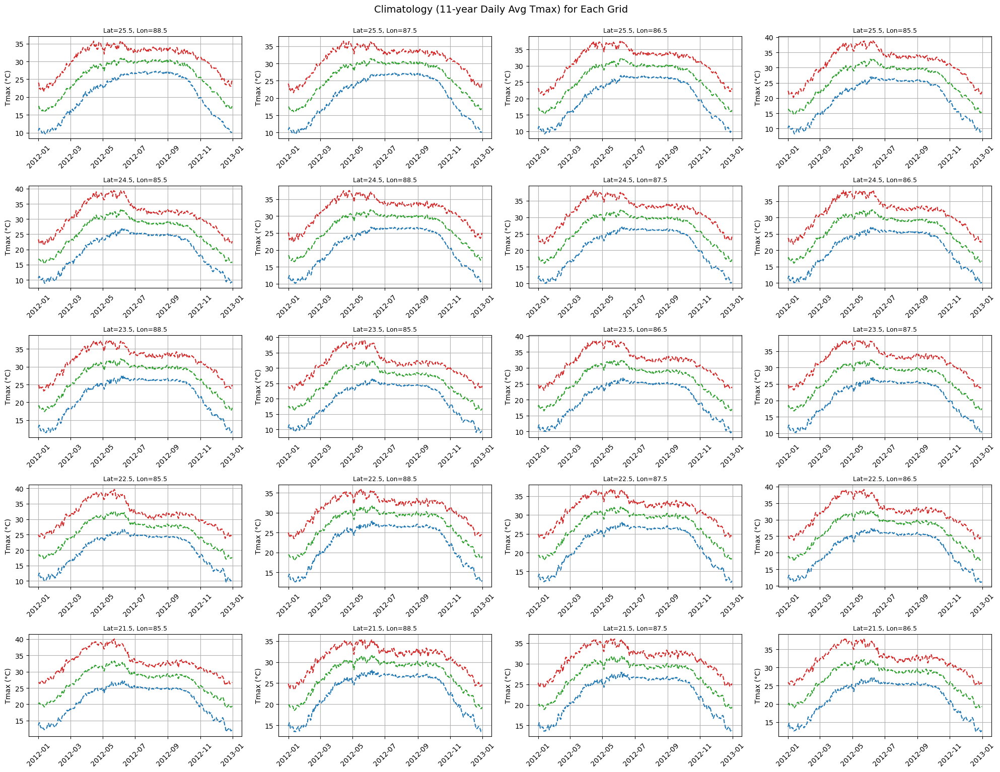

In [35]:
grid_normal['Date'] = pd.to_datetime(
    '2012-' + grid_normal['Month'].astype(str).str.zfill(2) + '-' + grid_normal['Day'].astype(str).str.zfill(2),
    errors='coerce'  # invalid dates will become NaT
)
grid_points = grid_normal[['Latitude', 'Longitude']].drop_duplicates().values
n = len(grid_points)
cols = 4  
rows = -(-n // cols)  
plt.figure(figsize=(cols*5, rows*3))

for i, (lat, lon) in enumerate(grid_points):
    subset = grid_normal[(grid_normal['Latitude'] == lat) & (grid_normal['Longitude'] == lon)]
    subset = subset.sort_values('Date')

    ax = plt.subplot(rows, cols, i+1)
    ax.plot(subset['Date'], subset['Tmax_11yr_avg'],linestyle='--', color='tab:red')
    ax.plot(subset['Date'], subset['Tmin_11yr_avg'],linestyle='--', color='tab:blue')
    ax.plot(subset['Date'], subset['Tmean_11yr_avg'],linestyle='--', color='tab:green')
    ax.set_title(f'Lat={lat}, Lon={lon}', fontsize=9)
    ax.set_xlabel('')
    ax.set_ylabel('Tmax (°C)')
    ax.tick_params(axis='x', labelrotation=45)
    plt.grid(True)

plt.tight_layout()
plt.suptitle('Climatology (11-year Daily Avg Tmax) for Each Grid', fontsize=14, y=1.02)
plt.show()

In [37]:
df_merged = pd.merge(
    df,
    grid_normal,
    on=['Latitude', 'Longitude', 'Month', 'Day'],
    how='left'
)

#df_merged = df_merged.sort_values(by='Latitude', ascending=False)

#df['Month'] = df['Date'].dt.month
#df['Day'] = df['Date'].dt.day
#df_merged = pd.merge(df, grid_avg_tmean, on=['Latitude', 'Longitude', 'Month', 'Day'], how='left')

df_merged.rename(columns={'Date_x': 'Date', 'Date_y': 'Climatology_Date'}, inplace=True)
print(df_merged.head())
df_merged.to_csv('All_normals.csv', index=False)

        Date  Latitude  Longitude   Tmax   Tmin  Rain   Tmean  Month  Day  \
0 2012-01-01      21.5       85.5  28.45  17.24   0.0  22.845      1    1   
1 2012-01-02      21.5       85.5  27.20  17.68   0.0  22.440      1    2   
2 2012-01-03      21.5       85.5  27.56  17.51   0.0  22.535      1    3   
3 2012-01-04      21.5       85.5  25.63  17.69   0.0  21.660      1    4   
4 2012-01-05      21.5       85.5  27.87  18.00   0.0  22.935      1    5   

   Tmax_11yr_avg  Tmean_11yr_avg  Tmin_11yr_avg Climatology_Date  
0      26.641558       20.079762      13.517967       2012-01-01  
1      26.625483       20.375367      14.125250       2012-01-02  
2      26.457708       20.423900      14.390092       2012-01-03  
3      26.350358       20.075042      13.799725       2012-01-04  
4      26.976725       20.042537      13.108350       2012-01-05  


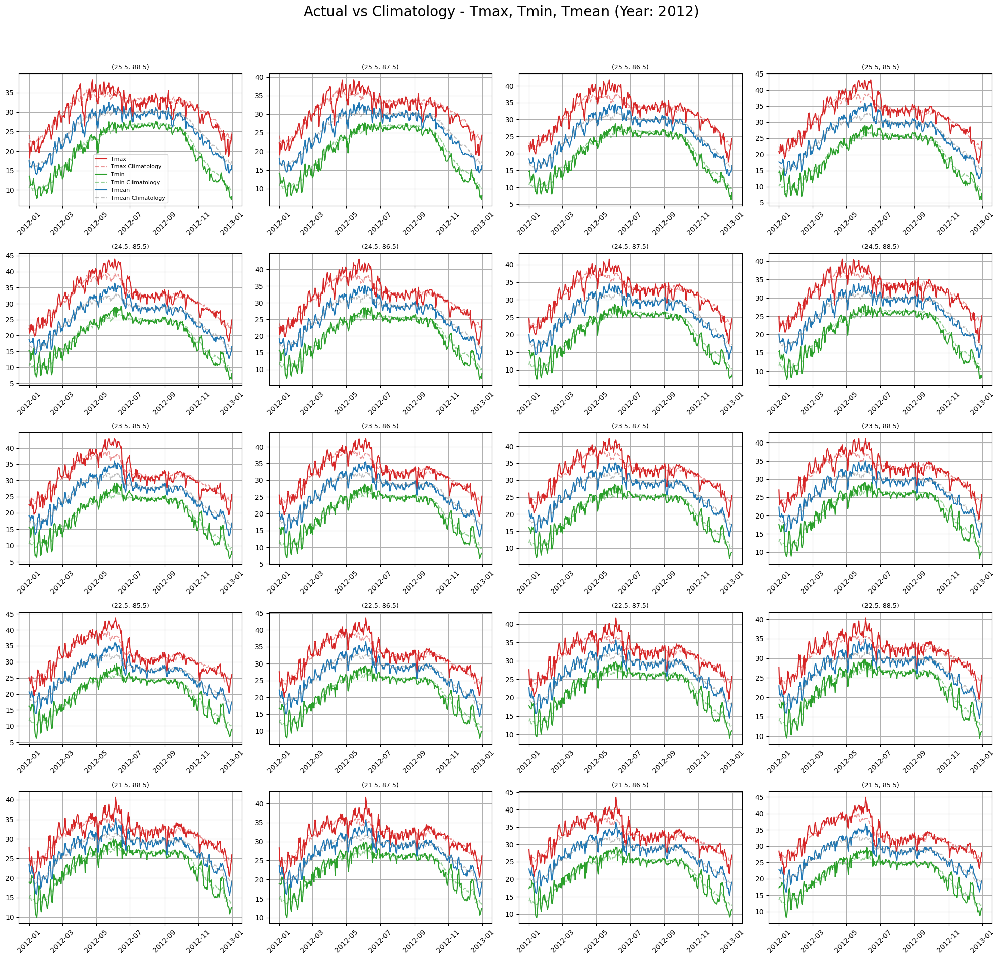

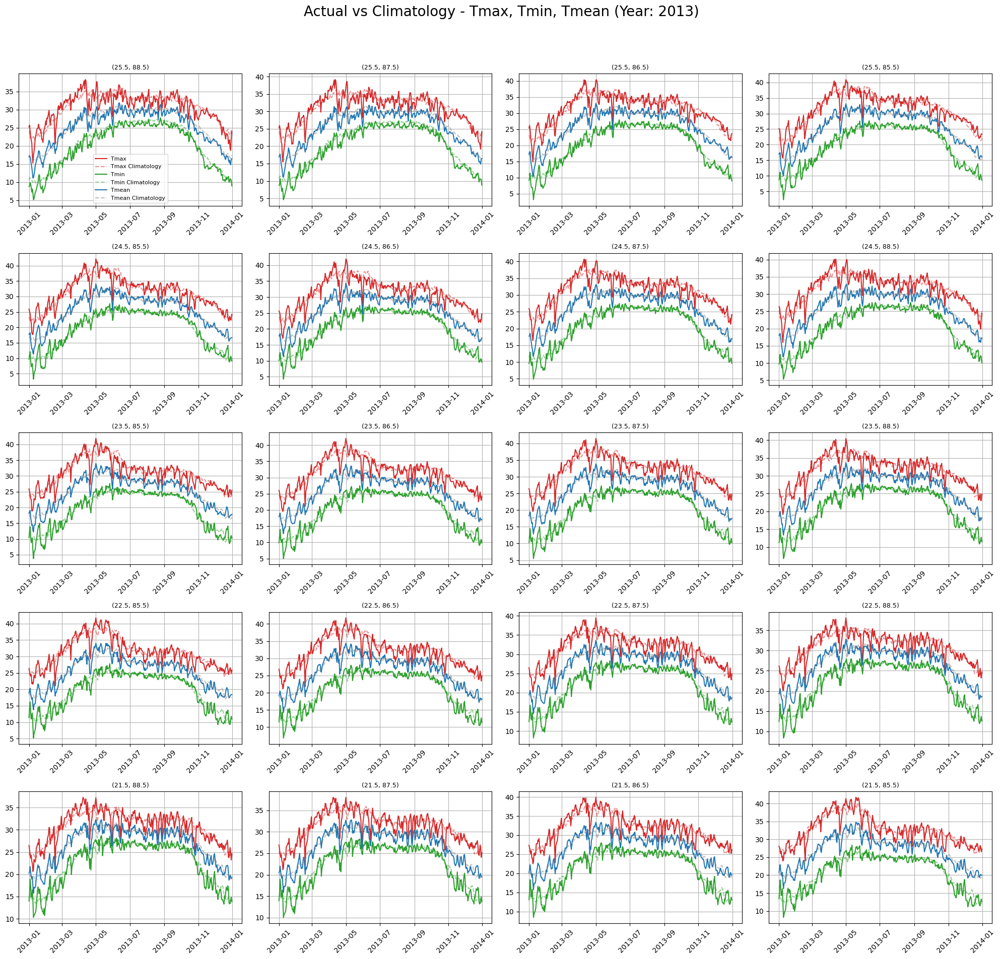

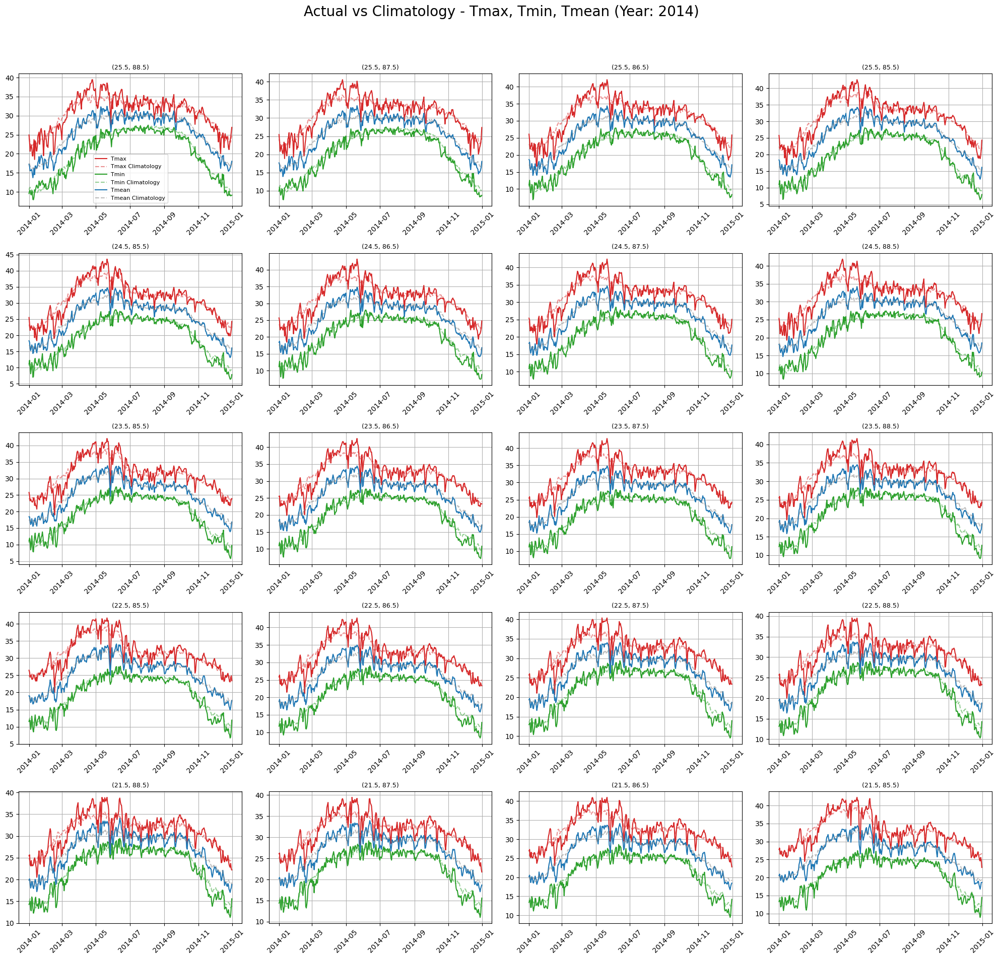

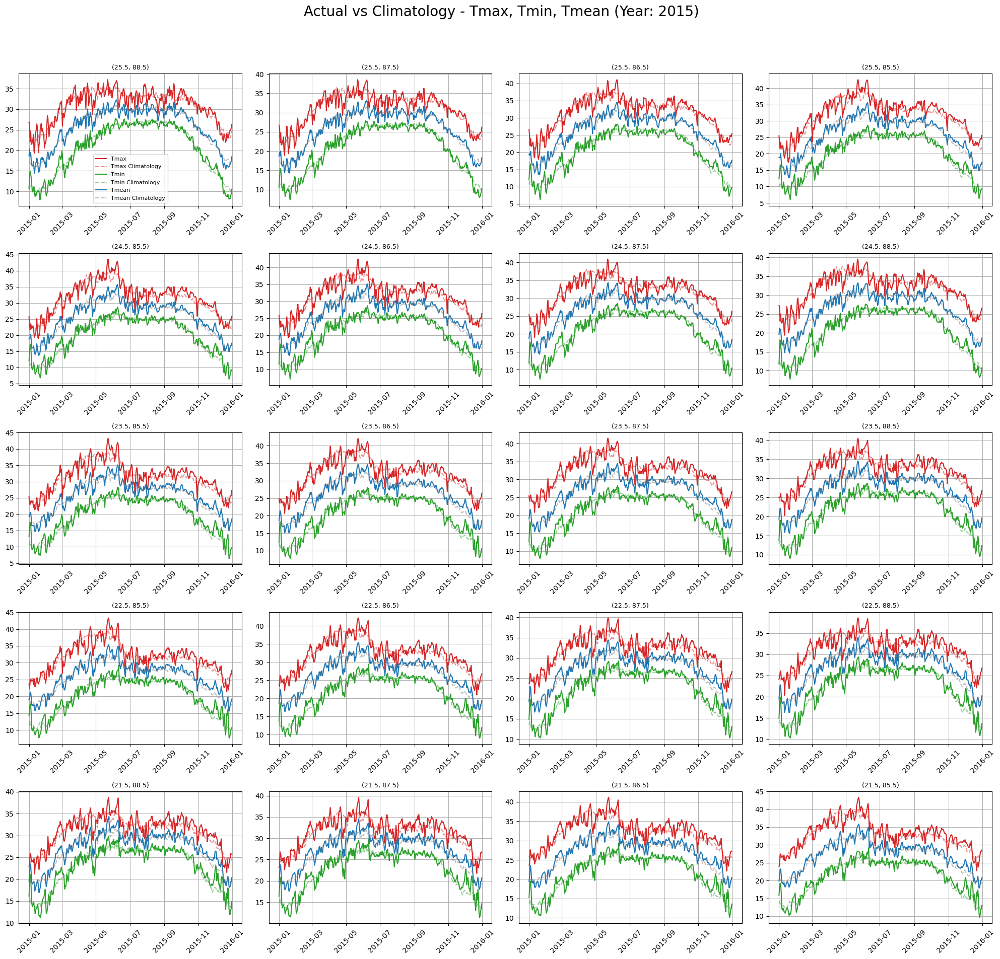

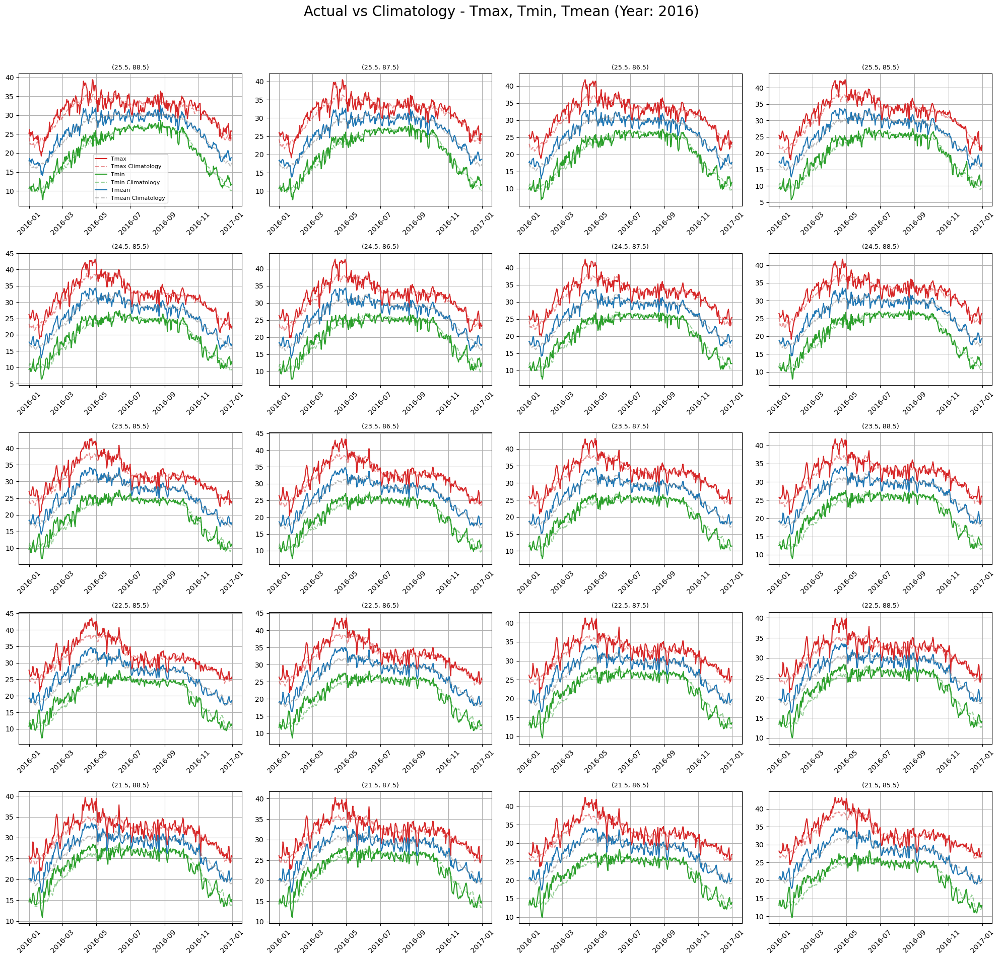

...

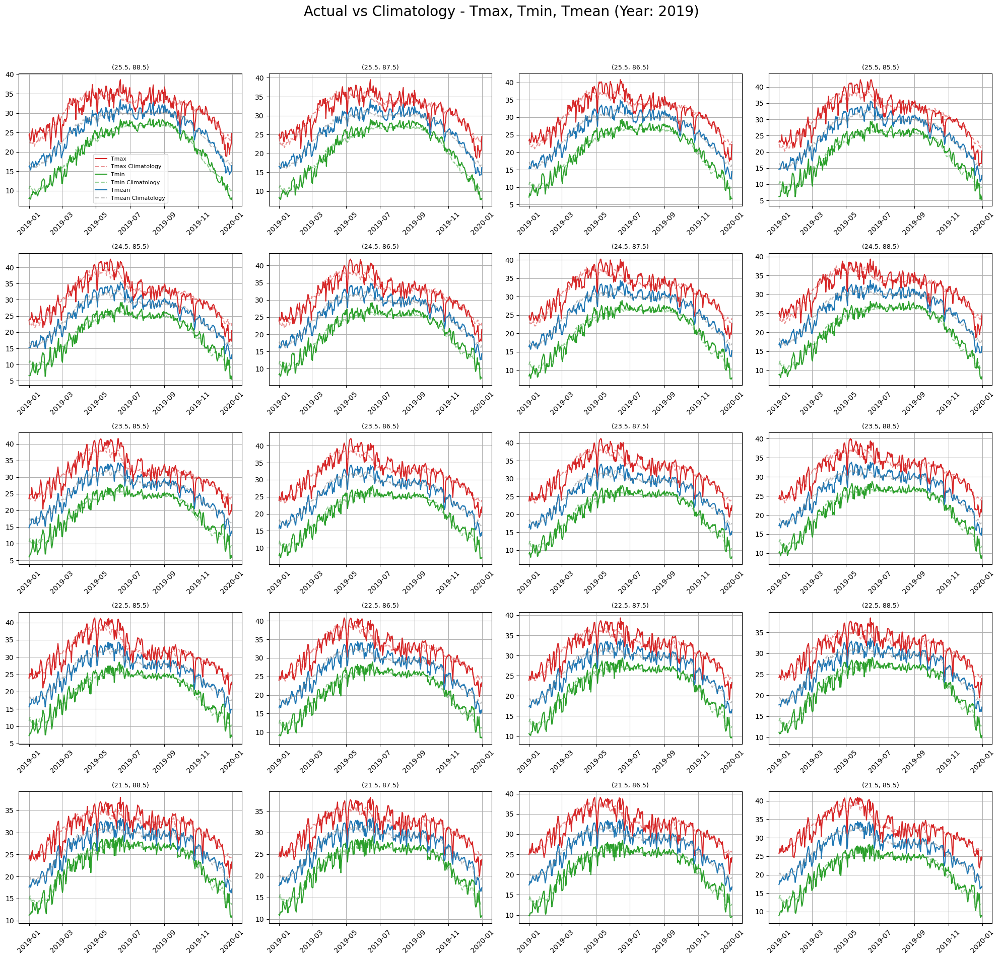

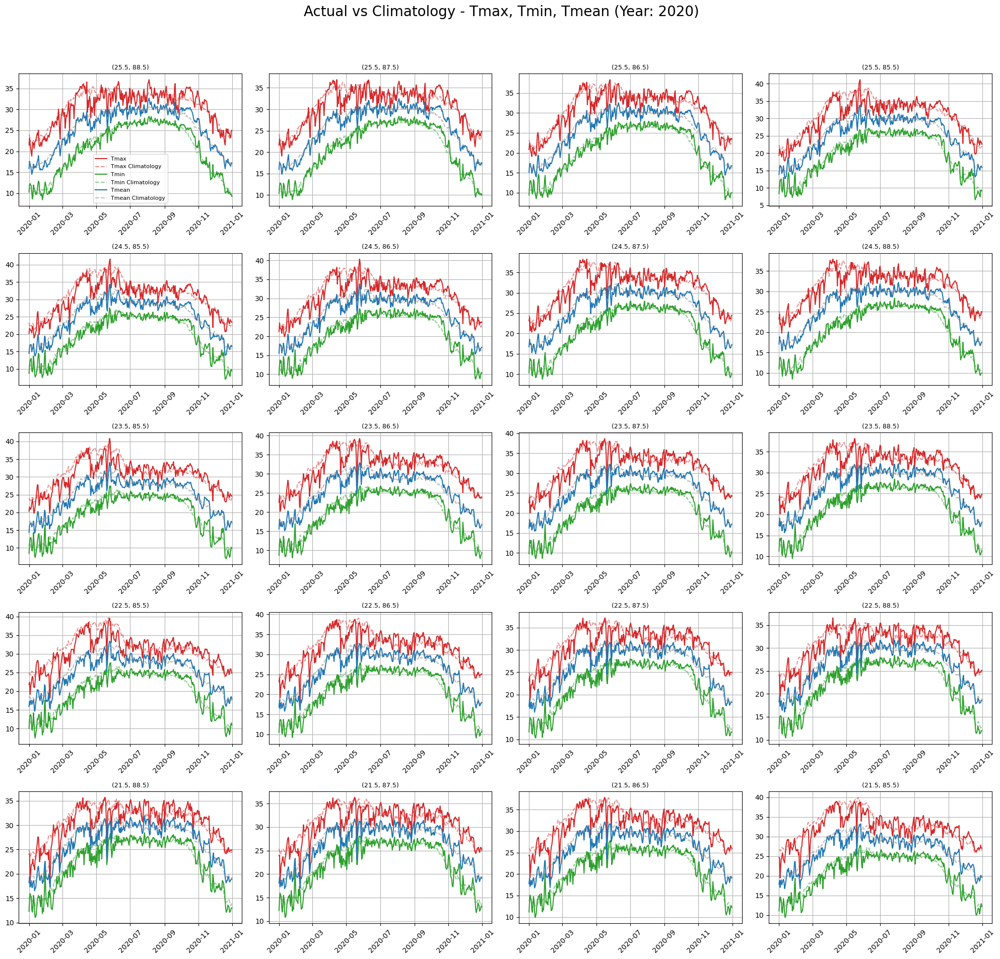

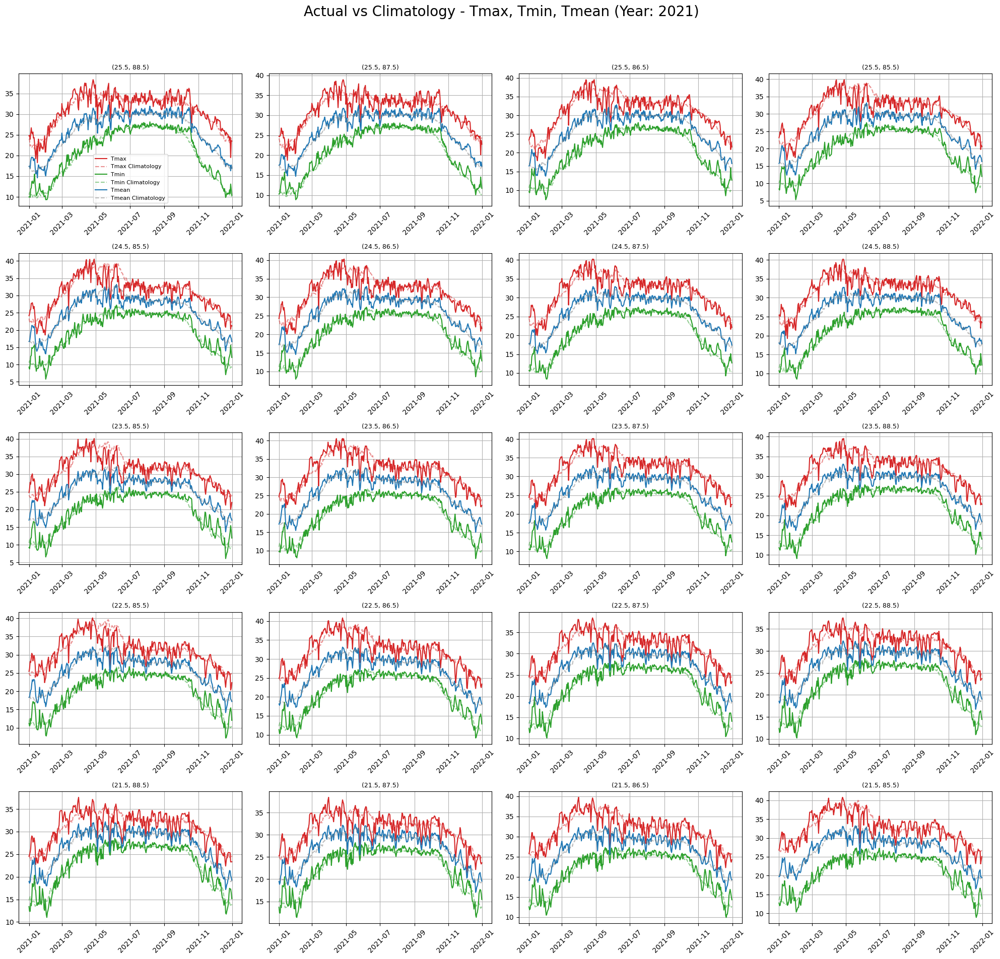

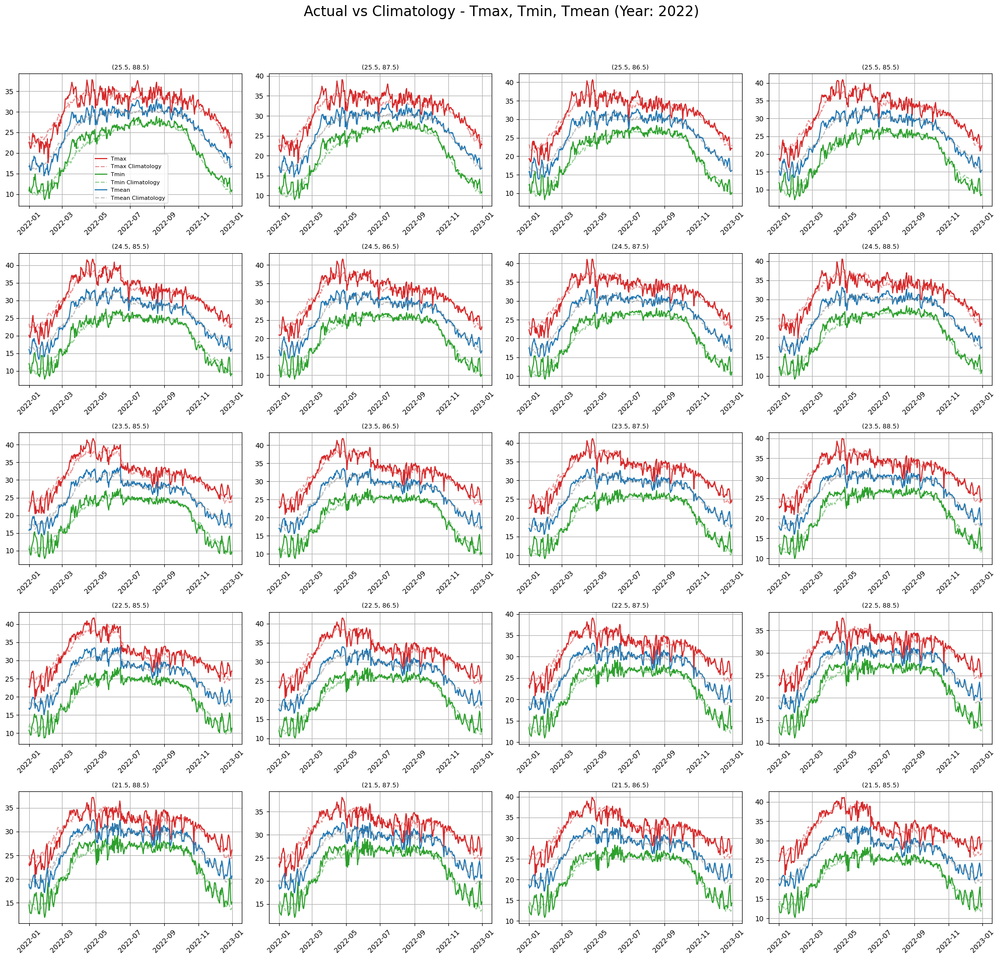

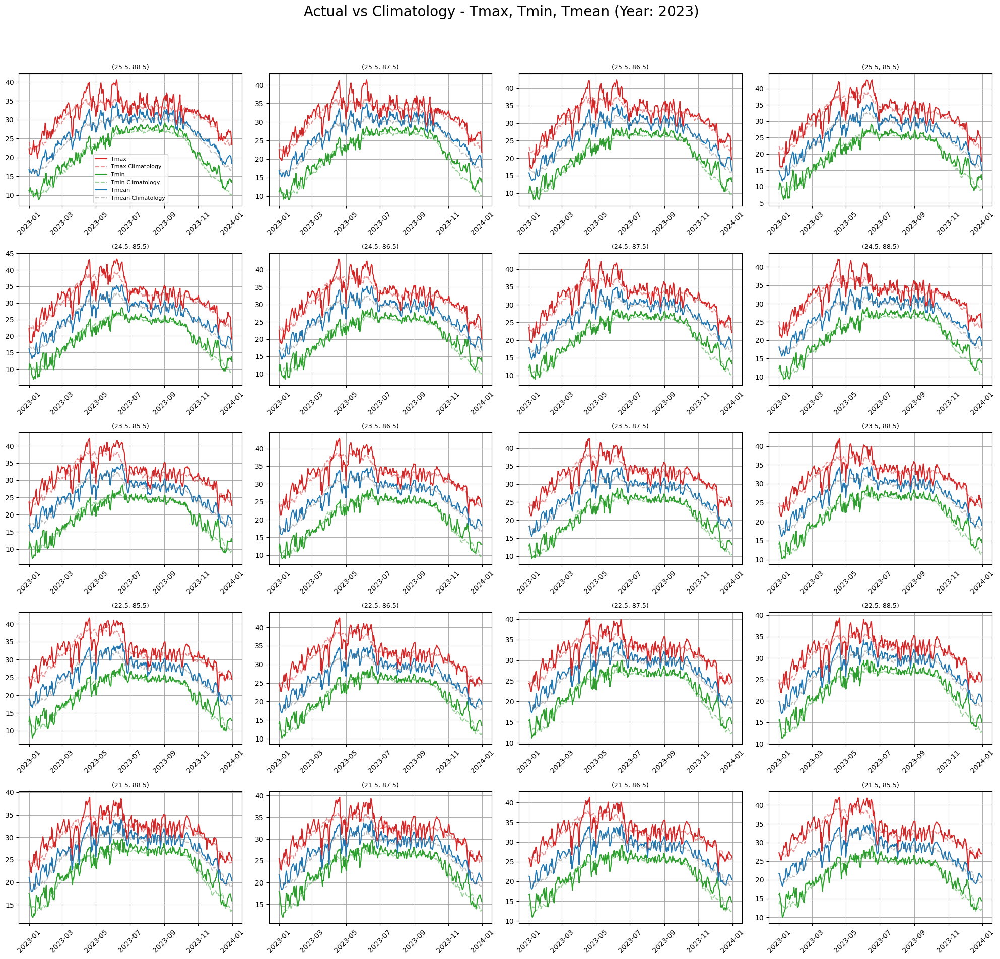

In [50]:
grid_points = df_merged[['Latitude', 'Longitude']].drop_duplicates().sort_values(by='Latitude', ascending=False).values
years = sorted(df_merged['Date'].dt.year.unique())

for year in years:
    fig, axs = plt.subplots(5, 4, figsize=(20, 20))  # 5 rows, 4 columns
    fig.suptitle(f'Actual vs Climatology - Tmax, Tmin, Tmean (Year: {year})', fontsize=20)

    for i, (lat, lon) in enumerate(grid_points):
        ax = axs[i // 4, i % 4]
        
        df_plot = df_merged[
            (df_merged['Latitude'] == lat) &
            (df_merged['Longitude'] == lon) &
            (df_merged['Date'].dt.year == year)
        ]

        # Plot actual and climatology
        ax.plot(df_plot['Date'], df_plot['Tmax'], label='Tmax', color='tab:red')
        ax.plot(df_plot['Date'], df_plot['Tmax_11yr_avg'], linestyle='--', label='Tmax Climatology', color='tab:red', alpha=0.5)
        
        ax.plot(df_plot['Date'], df_plot['Tmin'], label='Tmin', color='tab:green')
        ax.plot(df_plot['Date'], df_plot['Tmin_11yr_avg'], linestyle='--', label='Tmin Climatology', color='tab:green', alpha=0.5)

        ax.plot(df_plot['Date'], df_plot['Tmean'], label='Tmean', color='tab:blue')
        ax.plot(df_plot['Date'], df_plot['Tmean_11yr_avg'], linestyle='--', label='Tmean Climatology', color='tab:gray', alpha=0.5)

        ax.set_title(f'({lat}, {lon})', fontsize=9)
        ax.tick_params(axis='x', labelrotation=45)
        ax.set_aspect('auto')  # Equal aspect may squash the graph too much
        ax.grid(True)

        if i == 0:
            ax.legend(fontsize=8)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()